# Predicting air temperatures from LST

In [36]:
import pandas as pd
import geopandas as gpd
from pykrige.ok import OrdinaryKriging
import numpy as np
from shapely.geometry import Point
import hvplot.pandas
from shapely.geometry import box

In [2]:
air_temps_2023 = pd.read_csv(r"C:\LocalOneDrive\Documents\Desktop\MTI\UHI-Project\MSE-ES-UHI\Data\WeatherReadings\AirTemperature\AirTemperature_2023.csv")
station_metadata_2023 = pd.read_csv(r"C:\LocalOneDrive\Documents\Desktop\MTI\UHI-Project\MSE-ES-UHI\Data\WeatherReadings\AirTemperature\AirTemperature_metadata_2023.csv")
cc30_2023_pixels = pd.read_csv(r"C:\LocalOneDrive\Documents\Desktop\MTI\UHI-Project\MSE-ES-UHI\Data\FilteredData\2023_sg_excl_nature_cc30.csv")

In [3]:
air_temps_2023[air_temps_2023['timestamp'].astype(str).apply(lambda x: x.startswith('2023-10-13T11:16:00'))]

,timestamp,station_id,temperature
5435150,2023-10-13T11:16:00+08:00,S109,32.2
5435151,2023-10-13T11:16:00+08:00,S117,31.3
5435152,2023-10-13T11:16:00+08:00,S50,32.4
5435153,2023-10-13T11:16:00+08:00,S107,30.1
5435154,2023-10-13T11:16:00+08:00,S43,32.0
5435155,2023-10-13T11:16:00+08:00,S44,31.4
5435156,2023-10-13T11:16:00+08:00,S121,32.6
5435157,2023-10-13T11:16:00+08:00,S111,32.8
5435158,2023-10-13T11:16:00+08:00,S60,30.3
5435159,2023-10-13T11:16:00+08:00,S115,31.2


In [3]:
cc9_2023 = air_temps_2023[air_temps_2023['timestamp'].astype(str).apply(lambda x: x.startswith('2023-10-13T11:16:00'))]

In [4]:
station_metadata_2023 = station_metadata_2023.rename(columns={'device_id': 'station_id'})
cc9_2023 = cc9_2023.merge(station_metadata_2023, on='station_id', how='left')

In [24]:
cc9_2023_pixels = cc30_2023_pixels[cc30_2023_pixels['time'] == '2023-10-13']
cc9_2023_pixels_gdf = gpd.GeoDataFrame(cc9_2023_pixels, geometry=gpd.points_from_xy(cc9_2023_pixels.Longitude, cc9_2023_pixels.Latitude))

## Performing Kringing Interpolation

Plotting Enabled

Initializing variogram model...
Coordinates type: 'geographic' 

Using 'spherical' Variogram Model
Partial Sill: 0.48548803450120886
Full Sill: 0.8113346629503925
Range: 0.061956815366913304
Nugget: 0.3258466284491836 



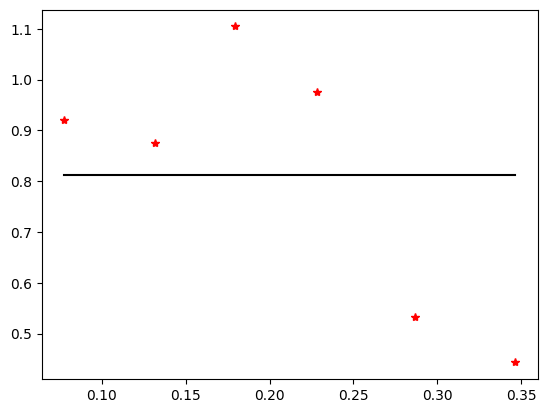

Calculating statistics on variogram model fit...
Executing Ordinary Kriging...

    Longitude  Latitude    AirTemp  Variance
0  103.618430      1.25  31.576231  0.861886
1  103.618795      1.25  31.576170  0.861864
2  103.619159      1.25  31.576099  0.861839
3  103.619524      1.25  31.576019  0.861811
4  103.619888      1.25  31.575930  0.861782


In [6]:
# Convert to a GeoDataFrame
cc9_2023_gdf = gpd.GeoDataFrame(
    cc9_2023, geometry=gpd.points_from_xy(cc9_2023.longitude, cc9_2023.latitude))

# Variogram analysis (example parameters)
OK = OrdinaryKriging(
    cc9_2023['longitude'].values,
    cc9_2023['latitude'].values,
    cc9_2023['temperature'].values,
    variogram_model='spherical',
    verbose=True,
    enable_plotting=True,
    coordinates_type='geographic'
)

# Create a grid over Singapore (example boundaries and resolution)
grid_lon = np.linspace(cc9_2023['longitude'].min(), cc9_2023['longitude'].max(), 1000)
grid_lat = np.linspace(cc9_2023['latitude'].min(), cc9_2023['latitude'].max(), 1000)

# Perform kriging
z, ss = OK.execute('grid', grid_lon, grid_lat)

# Meshgrid for longitude and latitude
mesh_lon, mesh_lat = np.meshgrid(grid_lon, grid_lat)

# Flatten the grid and kriging results to create DataFrame
kriging_df = pd.DataFrame({
    'Longitude': mesh_lon.ravel(),
    'Latitude': mesh_lat.ravel(),
    'AirTemp': z.ravel(),
    'Variance': ss.ravel()
})

# Print the first few rows of the kriged DataFrame to check the results
print(kriging_df.head())

In [23]:
kriging_gdf = gpd.GeoDataFrame(kriging_df, geometry=gpd.points_from_xy(kriging_df.Longitude, kriging_df.Latitude))

In [10]:
min_temp = kriging_gdf['AirTemp'].min()
max_temp = kriging_gdf['AirTemp'].max()

air_temp_plot = kriging_gdf.hvplot(
    geo=True,
    c='AirTemp',
    cmap='oranges',
    clim=(min_temp, max_temp),
    hover_cols=['Average_Temp'],
    tiles='OSM',
    colorbar=True,
    frame_width=500,
    frame_height=500,
)

air_temp_plot

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [Longitude,Latitude]   (AirTemp)

In [46]:
if kriging_gdf.crs is None:
    kriging_gdf = kriging_gdf.set_crs('EPSG:4326')

if cc9_2023_pixels_gdf.crs is None:
    cc9_2023_pixels_gdf = cc9_2023_pixels_gdf.set_crs('EPSG:4326')

In [47]:
cc9_2023_pixels_gdf = cc9_2023_pixels_gdf.to_crs('EPSG:3857')
print("Pixels CRS after conversion:", cc9_2023_pixels_gdf.crs)

# Create 30m x 30m boxes around each point
half_width = 15  # 15 meters half-width for a 30m box
cc9_2023_pixels_gdf['geometry'] = cc9_2023_pixels_gdf.geometry.apply(
    lambda p: box(p.x - half_width, p.y - half_width, p.x + half_width, p.y + half_width))

Pixels CRS after conversion: EPSG:3857


In [49]:
if cc9_2023_pixels_gdf.crs == 'EPSG:3857':
    cc9_2023_pixels_gdf = cc9_2023_pixels_gdf.to_crs('EPSG:4326')

In [51]:
cc9_2023_pixels_air_temps_gdf = gpd.sjoin(kriging_gdf, cc9_2023_pixels_gdf, how='inner', op='intersects')

# Print results to verify the join
print(cc9_2023_pixels_air_temps_gdf.head())

c:\Users\teomi\AppData\Local\Programs\Python\Python310\lib\site-packages\IPython\core\interactiveshell.py:3448: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


      Longitude_left  Latitude_left    AirTemp  Variance  \
0         103.618430       1.250000  31.576231  0.861886   
1000      103.618430       1.250194  31.575656  0.861558   
1         103.618795       1.250000  31.576170  0.861864   
1001      103.618795       1.250194  31.575593  0.861535   
2         103.619159       1.250000  31.576099  0.861839   

                       geometry  index_right  Unnamed: 0  Longitude_right  \
0     POINT (103.61843 1.25000)      3385235     1445308       103.618455   
1000  POINT (103.61843 1.25019)      3385235     1445308       103.618455   
1     POINT (103.61879 1.25000)      3385236     1445309       103.618725   
1001  POINT (103.61879 1.25019)      3385236     1445309       103.618725   
2     POINT (103.61916 1.25000)      3385238     1445311       103.619264   

      Latitude_right    SR_B1  ...  ST_DRAD  ST_EMIS  ST_EMSD  ST_QA  ST_TRAD  \
0           1.250061   9776.0  ...   1958.0   9880.0      0.0  429.0   9922.0   
1000        1.